# 9. Mapas


O principal pacote para criar mapas em *Python* é o **geopandas**. 

Se essa é a primeira vez que você usa o pacote, será necessário instalá-lo. 

Para instalar a primeira vez, você pode utilizar o seguinte comando: 

    !pip install geopandas

Com o **geopandas** instalado, vamos primeiro importar o pacote e em seguida abrir os dados: 

In [1]:
import geopandas 

Os arquivos de mapas são organizados no formato *shape*. Para o Brasil, o Instituto Brasileiro de Geografia e Estatística (IBGE), disponibiliza diversos arquivos desse tipo (https://www.ibge.gov.br/geociencias/organizacao-do-territorio/malhas-territoriais/15774-malhas.html?=&t=acesso-ao-produto). 

Vamos usar o arquivo para o Brasil, por Unidades da Federação. Você pode encontrar esses dados [AQUI](http://nedurcode.com/python/BR_UF_2021.zip). Baixe a pasta, descompacte os arquivos e salve todos os arquivos no seu diretório de trabalho, dentro de uma mesma pasta com o nome **BR_UF_2021**. 

Com os arquivos salvos no seu diretório de trabalho, agora sim, podemos fazer a leitura dos dados: 

In [2]:
UF = geopandas.read_file("BR_UF_2021")

UF.head()

,CD_UF,NM_UF,SIGLA,NM_REGIAO,geometry
0,11,Rondônia,RO,Norte,"POLYGON ((-62.86662 -7.97587, -62.86017 -7.982..."
1,12,Acre,AC,Norte,"POLYGON ((-73.16550 -7.34166, -73.05480 -7.381..."
2,13,Amazonas,AM,Norte,"POLYGON ((-67.32609 2.02971, -67.31682 2.00125..."
3,14,Roraima,RR,Norte,"POLYGON ((-60.20051 5.26434, -60.19828 5.26045..."
4,15,Pará,PA,Norte,"MULTIPOLYGON (((-46.43676 -1.01905, -46.43723 ..."


Agora que o *shape file* já foi lido, vamos primeiro juntar as informações sobre exportações, da seção anterior, com as informações desse arquivo. 

Novamente, precisamos importar o pacote **pandas** e os dados da seção anterior: 

In [3]:
import pandas as pd

dados = pd.read_excel("EXP2019_ComexStat.xlsx")

Observe que a informação em comum nas duas bases de dados é a sigla de UF: 

In [4]:
dados.head()

,ano,uf,exp
0,2019,AC,0.032853
1,2019,AL,0.319089
2,2019,AM,0.731092
3,2019,AP,0.261368
4,2019,BA,8.168158


Para unir as duas bases de dados, vamos usar o método .`merge()`, conforme o código abaixo: 

In [5]:
UF = UF.merge(dados, left_on='SIGLA', right_on='uf')

Observe que estamos atualizando a base do mapa, chamada **UF**, acrescentando os dados da base importada com o nome **dados**, sendo que os dados serão adicionados considerando a coluna *SIGLA* da base de dados da esquerda (i.e., **UF**), com a coluna *uf* da base de dados da direita (i.e., **dados**). 

Para visualizar os dados após a integração das bases, basta reabriar o início da base original: 

In [6]:
UF.head()

,CD_UF,NM_UF,SIGLA,NM_REGIAO,geometry,ano,uf,exp
0,11,Rondônia,RO,Norte,"POLYGON ((-62.86662 -7.97587, -62.86017 -7.982...",2019,RO,1.303910
1,12,Acre,AC,Norte,"POLYGON ((-73.16550 -7.34166, -73.05480 -7.381...",2019,AC,0.032853
2,13,Amazonas,AM,Norte,"POLYGON ((-67.32609 2.02971, -67.31682 2.00125...",2019,AM,0.731092
3,14,Roraima,RR,Norte,"POLYGON ((-60.20051 5.26434, -60.19828 5.26045...",2019,RR,0.157707
4,15,Pará,PA,Norte,"MULTIPOLYGON (((-46.43676 -1.01905, -46.43723 ...",2019,PA,17.841239


O jeito mais simples de visualizar os dados é utilizando o método `.plot()` do *geopandas*: 

<AxesSubplot:>

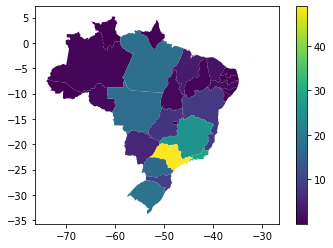

In [7]:
UF.plot("exp", legend=True)

Além da opção de legenda, utilizada no exemplo anterior, o método `plot()`possui diversos outros argumentos. 

Como no exemplo abaixo, você pode definir que os valores (no nosso caso, os valores de exportações) serão divididos em quantis (*scheme='quantiles'*), que o número de grupos será quatro (*k=4*), que as cores do mapa serão tons de verde (*cmap='Greens'*), que a cor da borda das divisões (nesse caso, entre UFs) será cinza (*edgecolor='grey'*), e que a figura terá um tamanho de 15 por 10 cm (*figsize=(15, 10)*). 

Outros argumentos podem ser consultados na documentação do [*geopandas*](https://geopandas.org/en/stable/docs/reference/api/geopandas.GeoDataFrame.plot.html). 

<AxesSubplot:>

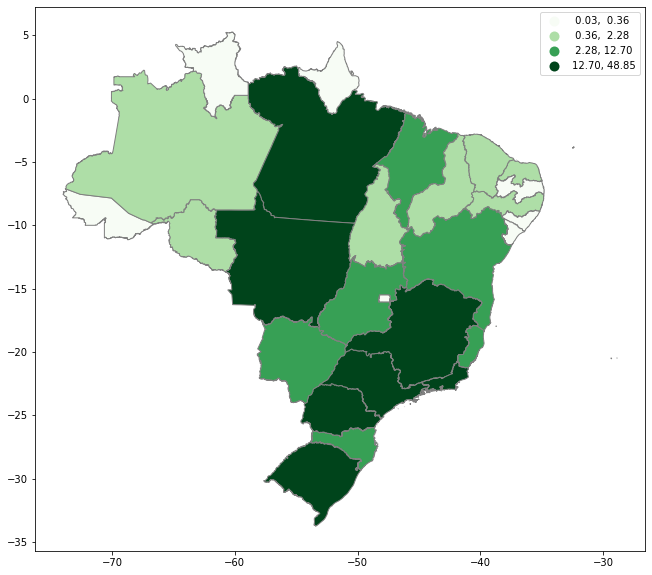

In [8]:
UF.plot(
    "exp", 
    legend=True,  
    scheme='quantiles',
    k=4,
    cmap='Greens',
    edgecolor='grey',    
    figsize=(15, 10)
)

Assim como o **pandas**, o **geopandas** está usando o **matplotlib** no background. Mais opções de cores podem ser consultadas em: https://matplotlib.org/2.0.2/users/colormaps.html

Para salvar o mapa como png, precisamos colocá-lo como um *subplot* do *matplotlib* como mostra o exemplo a seguir: 

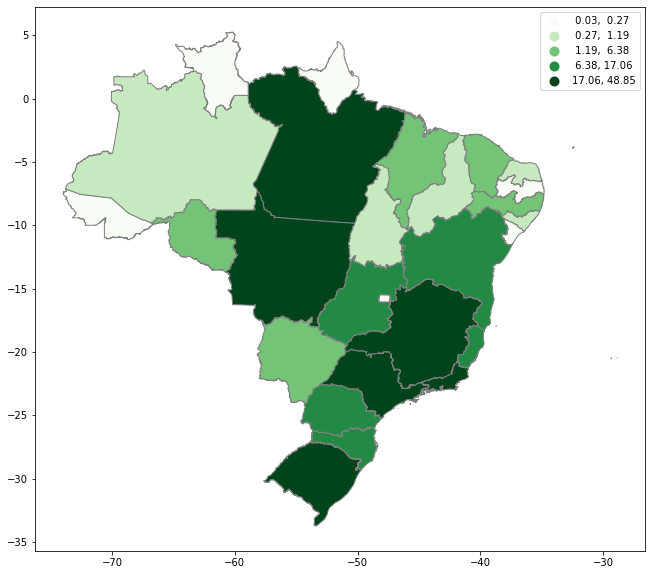

In [9]:
import matplotlib.pyplot as plt 

fig, ax = plt.subplots(figsize=(15,10))
UF.plot(
    "exp", 
    legend=True,
    cmap='Greens',
    scheme='quantiles',
    figsize=(15,10),
    edgecolor='grey',
    ax=ax
)
fig.savefig("Exportações2019.png")

Uma outra forma de visualizar os dados é por meio do método `explore()`, que cria gráficos interativos, como nesse exemplo:

In [10]:
UF.explore(
    "exp", 
    legend=True,
    cmap='summer'
)